# Experiment 1

## Setting up

In [1]:
import numpy as np
from src.clip_linear_regression import LinearRegression
import torch
from torch.autograd import Variable
import matplotlib.pyplot as plt
import clip
import cv2
from IPython.display import Video
from scipy import stats
from scipy.signal import savgol_filter

from src.clip_video_response import clip_video_response
from src.clip_video_response import get_num_video_frames

In [2]:
path = "..\\data\\videos\\ball_kick.mp4"
num_frames = get_num_video_frames(path)
# Note: uncomment if you want to view the video, otherwise leave commented.
# Embedding videos into notebook can cause UI to slow down
# 
# Video(path, embed=True)

In [3]:
response = clip_video_response()

## String querying 

In [37]:
queries = ["photo of a stationary soccer ball",
           "photo of a flying soccer ball",
           "photo of a person kicking a soccer ball"]

## Training Data

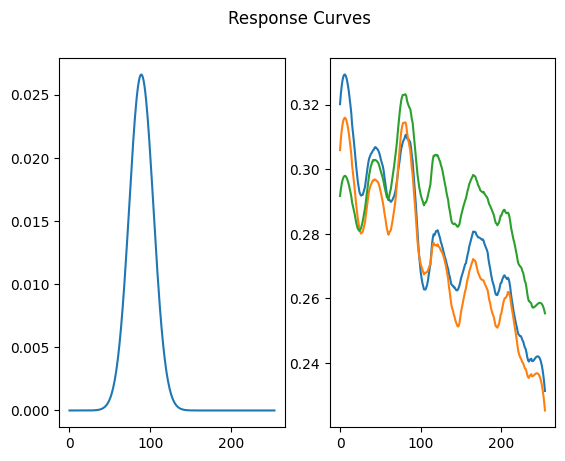

In [78]:
# Feature
generate_response = clip_video_response().generate_response_curve
responses = np.array([savgol_filter(generate_response(video_path=path, queries=[query], sampling_rate=1)[0], 30, 3) for query in queries])

# Label
center = 89
# slope for gaussian
slope = 15
# slope for sigmoid
# slope = 0.1

# gaussian curve
action_curve = np.array([1./(np.sqrt(2.*np.pi)*slope)*np.exp(-np.power((x - center)/slope, 2.)/2) for x in range(num_frames)])
# sigmoid curve
# action_curve = np.array([1-1/(1+np.exp(slope * ((x-center)/2))) for x in range(num_frames)])

fig, (ax1, ax2) = plt.subplots(1, 2)
fig.suptitle('Response Curves')

ax1.plot(action_curve)

for response in responses:
    ax2.plot(response)

## Model Training

In [84]:
inputDim = len(queries)
outputDim = 1
learningRate = 0.1 
epochs = 100000

model = LinearRegression(inputDim, outputDim)
##### For GPU #######
if torch.cuda.is_available():
    model.cuda()
    
criterion = torch.nn.MSELoss() 
optimizer = torch.optim.SGD(model.parameters(), lr=learningRate)

In [85]:
criterion = torch.nn.MSELoss() 
optimizer = torch.optim.SGD(model.parameters(), lr=learningRate)

In [86]:
for epoch in range(epochs):
    inputs = Variable(torch.from_numpy(responses).cuda().type(torch.float32))
    labels = Variable(torch.from_numpy(action_curve).cuda().type(torch.float32))

    optimizer.zero_grad()

    outputs = model(inputs)

    loss = criterion(outputs, labels)
    print(loss)
    loss.backward()

    optimizer.step()

    print('epoch {}, loss {}'.format(epoch, loss.item()))

tensor(0.0009, device='cuda:0', grad_fn=<MseLossBackward0>)
epoch 0, loss 0.0009065379854291677
tensor(0.0005, device='cuda:0', grad_fn=<MseLossBackward0>)
epoch 1, loss 0.000534337479621172
tensor(0.0003, device='cuda:0', grad_fn=<MseLossBackward0>)
epoch 2, loss 0.0003234510077163577
tensor(0.0002, device='cuda:0', grad_fn=<MseLossBackward0>)
epoch 3, loss 0.00020396336913108826
tensor(0.0001, device='cuda:0', grad_fn=<MseLossBackward0>)
epoch 4, loss 0.0001362621842417866
tensor(9.7903e-05, device='cuda:0', grad_fn=<MseLossBackward0>)
epoch 5, loss 9.790279727894813e-05
tensor(7.6168e-05, device='cuda:0', grad_fn=<MseLossBackward0>)
epoch 6, loss 7.616819493705407e-05
tensor(6.3853e-05, device='cuda:0', grad_fn=<MseLossBackward0>)
epoch 7, loss 6.385318556567654e-05
tensor(5.6875e-05, device='cuda:0', grad_fn=<MseLossBackward0>)
epoch 8, loss 5.6875342124840245e-05
tensor(5.2921e-05, device='cuda:0', grad_fn=<MseLossBackward0>)
epoch 9, loss 5.29214485140983e-05
tensor(5.0681e-05, d

## Evaluation

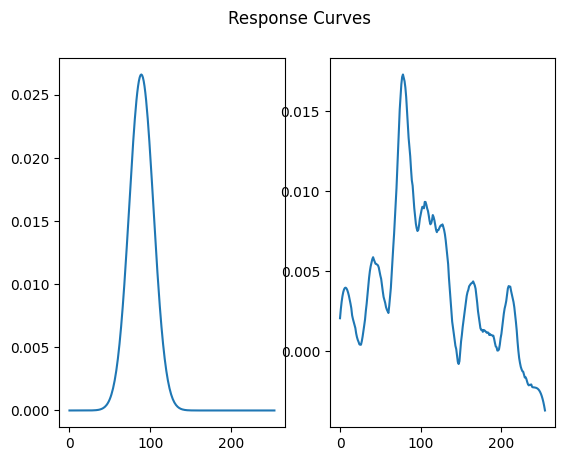

In [87]:
with torch.no_grad():
    predicted = model(Variable(torch.from_numpy(responses).cuda())).cpu().data.numpy()

fig, (ax1, ax2) = plt.subplots(1, 2)
fig.suptitle('Response Curves')

ax1.plot(action_curve)
ax2.plot(predicted)

In [88]:
for name, param in model.named_parameters():
    if param.requires_grad:
        print(name, param.data)

linear.weight tensor([[-0.4830,  0.5286,  0.1660]], device='cuda:0')
linear.bias tensor([-0.0535], device='cuda:0')


# Experiment 2

## Setting up

In [1]:
import numpy as np
from src.clip_linear_regression import LinearRegression
import torch
from torch.autograd import Variable
import matplotlib.pyplot as plt
import clip
import cv2
from IPython.display import Video
from scipy import stats
from scipy.signal import savgol_filter

from src.clip_video_response import clip_video_response
from src.clip_video_response import get_num_video_frames

In [2]:
path = "..\\data\\videos\\ball_kick.mp4"
num_frames = get_num_video_frames(path)
# Note: uncomment if you want to view the video, otherwise leave commented.
# Embedding videos into notebook can cause UI to slow down
# 
# Video(path, embed=True)

In [3]:
response = clip_video_response()

## String querying 

In [4]:
queries = [
    "Photograph of a stationary soccer ball.",
    "Image of a motionless soccer ball.",
    "Picture of a soccer ball at rest.",
    "Photo of a flying soccer ball.",
    "Image of a soccer ball in mid-air.",
    "Picture of a soccer ball soaring through the sky.",
    "Photograph of a person kicking a soccer ball.",
    "Image of an individual striking a soccer ball.",
    "Snapshot of someone booting a soccer ball.",
    "Photo of a soccer ball being kicked by a person."
]

## Training Data

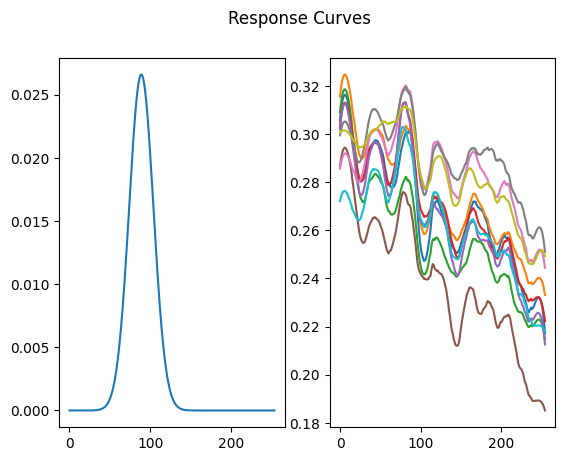

In [5]:
# Feature
generate_response = clip_video_response().generate_response_curve
responses = np.array([savgol_filter(generate_response(video_path=path, queries=[query], sampling_rate=1)[0], 30, 3) for query in queries])

# Label
center = 89
# slope for gaussian
slope = 15
# slope for sigmoid
# slope = 0.1

# gaussian curve
action_curve = np.array([1./(np.sqrt(2.*np.pi)*slope)*np.exp(-np.power((x - center)/slope, 2.)/2) for x in range(num_frames)])
# sigmoid curve
# action_curve = np.array([1-1/(1+np.exp(slope * ((x-center)/2))) for x in range(num_frames)])

fig, (ax1, ax2) = plt.subplots(1, 2)
fig.suptitle('Response Curves')

ax1.plot(action_curve)

for response in responses:
    ax2.plot(response)

## Model Training

In [11]:
inputDim = len(queries)
outputDim = 1
learningRate = 0.15 
epochs = 100000

model = LinearRegression(inputDim, outputDim)
##### For GPU #######
if torch.cuda.is_available():
    model.cuda()
    
criterion = torch.nn.MSELoss() 
optimizer = torch.optim.SGD(model.parameters(), lr=learningRate)

In [12]:
criterion = torch.nn.MSELoss() 
optimizer = torch.optim.SGD(model.parameters(), lr=learningRate)

In [13]:
for epoch in range(epochs):
    inputs = Variable(torch.from_numpy(responses).cuda().type(torch.float32))
    labels = Variable(torch.from_numpy(action_curve).cuda().type(torch.float32))

    optimizer.zero_grad()

    outputs = model(inputs)

    loss = criterion(outputs, labels)
    print(loss)
    loss.backward()

    optimizer.step()

    print('epoch {}, loss {}'.format(epoch, loss.item()))

tensor(0.0075, device='cuda:0', grad_fn=<MseLossBackward0>)
epoch 0, loss 0.0075373523868620396
tensor(0.0018, device='cuda:0', grad_fn=<MseLossBackward0>)
epoch 1, loss 0.0017842028755694628
tensor(0.0005, device='cuda:0', grad_fn=<MseLossBackward0>)
epoch 2, loss 0.00045122054871171713
tensor(0.0001, device='cuda:0', grad_fn=<MseLossBackward0>)
epoch 3, loss 0.00014236781862564385
tensor(7.0801e-05, device='cuda:0', grad_fn=<MseLossBackward0>)
epoch 4, loss 7.080066279741004e-05
tensor(5.4211e-05, device='cuda:0', grad_fn=<MseLossBackward0>)
epoch 5, loss 5.421117020887323e-05
tensor(5.0360e-05, device='cuda:0', grad_fn=<MseLossBackward0>)
epoch 6, loss 5.035984213463962e-05
tensor(4.9460e-05, device='cuda:0', grad_fn=<MseLossBackward0>)
epoch 7, loss 4.9459849833510816e-05
tensor(4.9244e-05, device='cuda:0', grad_fn=<MseLossBackward0>)
epoch 8, loss 4.924371023662388e-05
tensor(4.9186e-05, device='cuda:0', grad_fn=<MseLossBackward0>)
epoch 9, loss 4.918601916870102e-05
tensor(4.9165

## Evaluation

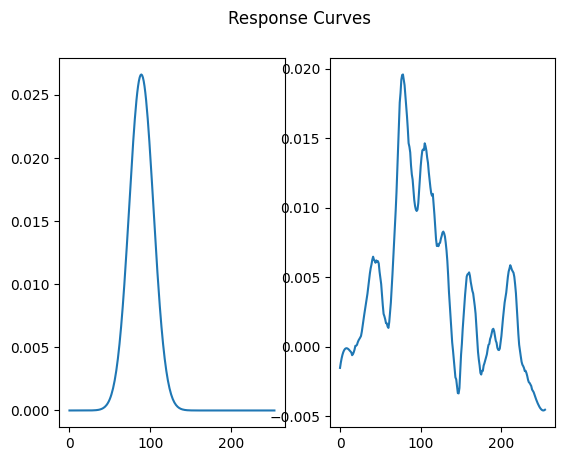

In [14]:
with torch.no_grad():
    predicted = model(Variable(torch.from_numpy(responses).cuda())).cpu().data.numpy()

fig, (ax1, ax2) = plt.subplots(1, 2)
fig.suptitle('Response Curves')

ax1.plot(action_curve)
ax2.plot(predicted)

In [15]:
for name, param in model.named_parameters():
    if param.requires_grad:
        print(name, param.data)

linear.weight tensor([[-0.1854,  0.0788, -0.4690,  0.0227,  0.3870,  0.2596,  0.3212, -0.2023,
         -0.1869,  0.0103]], device='cuda:0')
linear.bias tensor([-0.0007], device='cuda:0')


In [30]:
params = list(model.named_parameters())[0][1].cpu().detach().numpy()[0]
ind = np.argsort(params)
print([(query, value) for query, value in zip(np.take_along_axis(np.array(queries), ind, axis=0), np.sort(params))])

[('Picture of a soccer ball at rest.', -0.4690464), ('Image of an individual striking a soccer ball.', -0.20229916), ('Snapshot of someone booting a soccer ball.', -0.18692741), ('Photograph of a stationary soccer ball.', -0.18541735), ('Photo of a soccer ball being kicked by a person.', 0.010313353), ('Photo of a flying soccer ball.', 0.02265073), ('Image of a motionless soccer ball.', 0.07878374), ('Picture of a soccer ball soaring through the sky.', 0.2595819), ('Photograph of a person kicking a soccer ball.', 0.32120803), ('Image of a soccer ball in mid-air.', 0.38699722)]
